____
__Universidad de San Andrés__<br/>
__Visión Artificial__<br/>
__Trabajo Práctico 1: Panorámica__<br/>
__Martin Bianchi y Federico Gutman__
____

### Importamos las librerías necesarias

In [1]:
import sys
sys.path.append('src')

import cv2
import numpy as np
import matplotlib.pyplot as plt

from src.visualization import *
from src.utils import *
from src.methods import *

### Definimos las funciones necesarias

### Visualizamos las imágenes

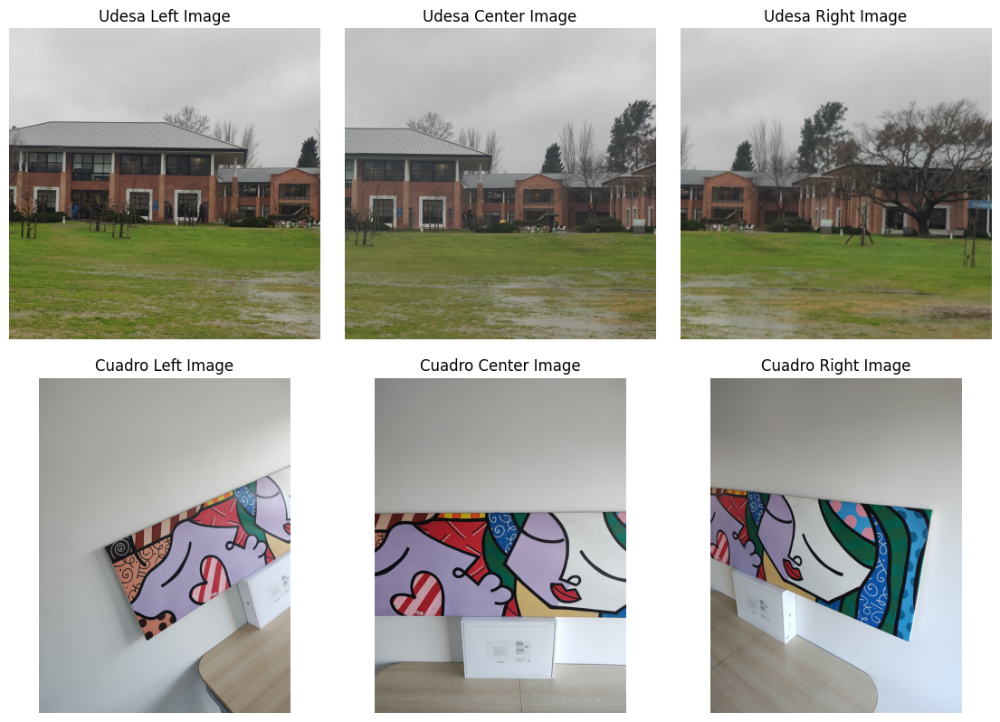

In [2]:
# cargo las imágenes y las paso a RGB
udesa  = [cv2.cvtColor(cv2.imread(f'img/udesa_{i}.jpg'),  cv2.COLOR_BGR2RGB) for i in range(3)]
cuadro = [cv2.cvtColor(cv2.imread(f'img/cuadro_{i}.jpg'), cv2.COLOR_BGR2RGB) for i in range(3)]

# muestro en una figura 2x3
show_triplets_2x3(udesa, cuadro)

### Seguimos el pipeline propuesto

#### Paso 1: Detección de características visuales

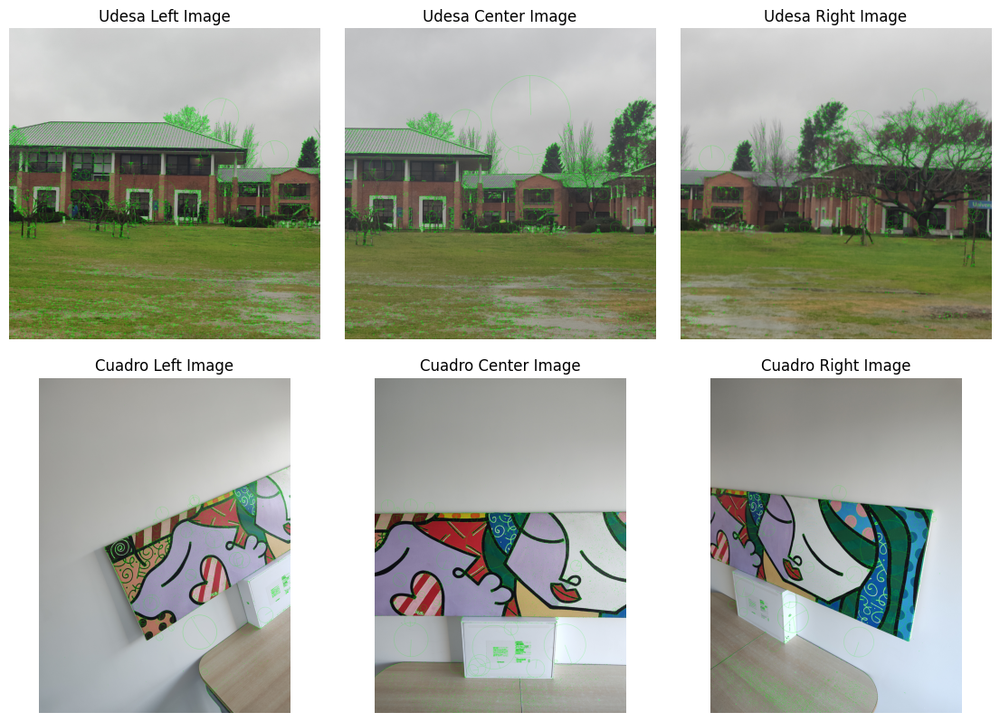

In [3]:
# aplicamos SIFT a ambos conjuntos de imágenes
(keypoints_udesa, descriptors_udesa, visual_udesa) = sift_kps_images(udesa)
(keypoints_cuadro, descriptors_cuadro, visual_cuadro) = sift_kps_images(cuadro)

# muestro las imágenes con los keypoints detectados
show_triplets_2x3(visual_udesa, visual_cuadro)

#### Paso 2: Supresión de No Máxima Adaptativa (ANMS)

/Users/fedegutman/Desktop/visión artificial/tp1_panoramica/src/visualization.py:36: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


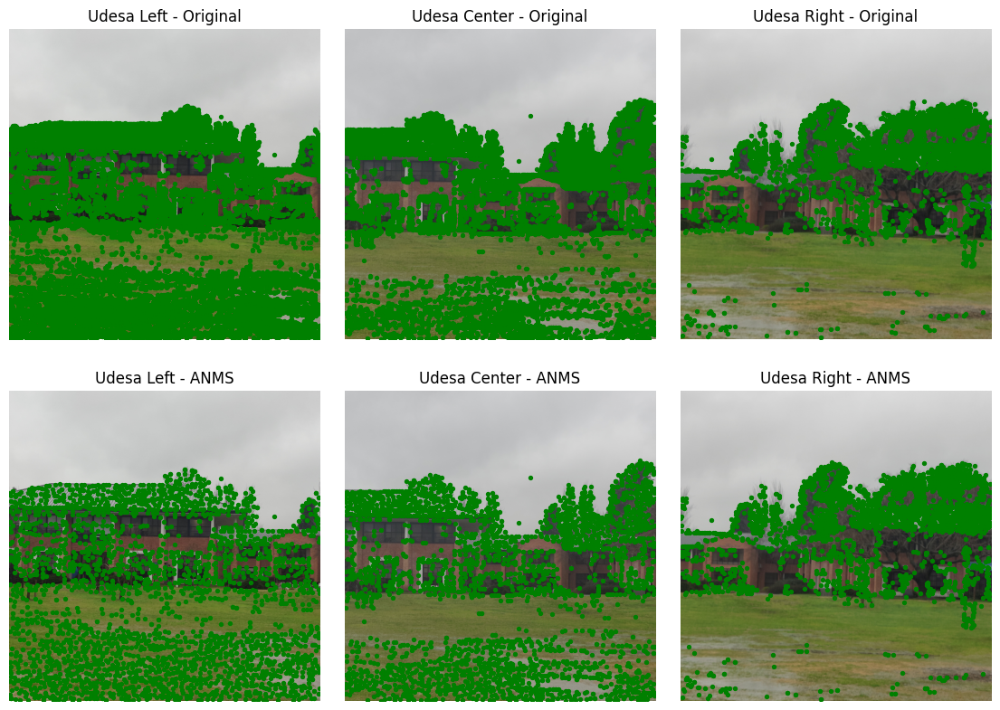

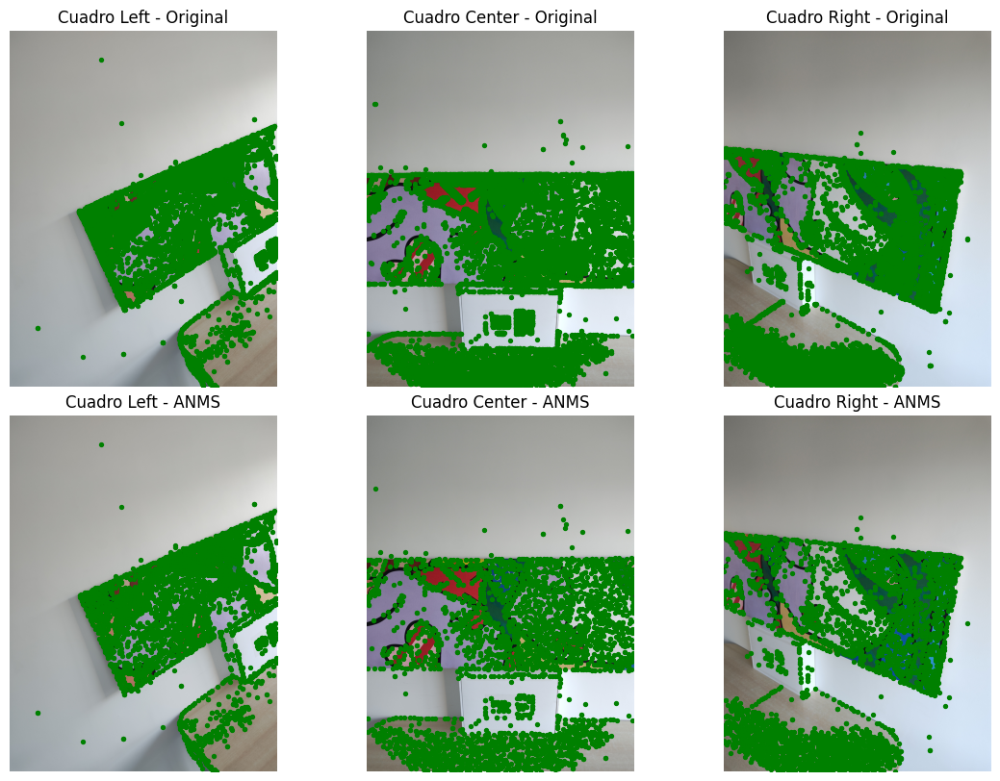

In [4]:
# aplico ANMS a ambos conjuntos de keypoints
keypoints_udesa_anms, descriptors_udesa_anms, radii_udesa = apply_anms_triplet(keypoints_udesa, descriptors_udesa, N=3000)
keypoints_cuadro_anms, descriptors_cuadro_anms, radii_cuadro = apply_anms_triplet(keypoints_cuadro, descriptors_cuadro, N=3000)

plot_triplet_keypoints(udesa, keypoints_udesa, keypoints_udesa_anms, title_prefix='Udesa')
plot_triplet_keypoints(cuadro, keypoints_cuadro, keypoints_cuadro_anms, title_prefix='Cuadro')

#### Paso 3: Descripción de las características

[UDESA] left-center -> lowe+cross: 222 matches
[UDESA] right-center -> lowe+cross: 58 matches


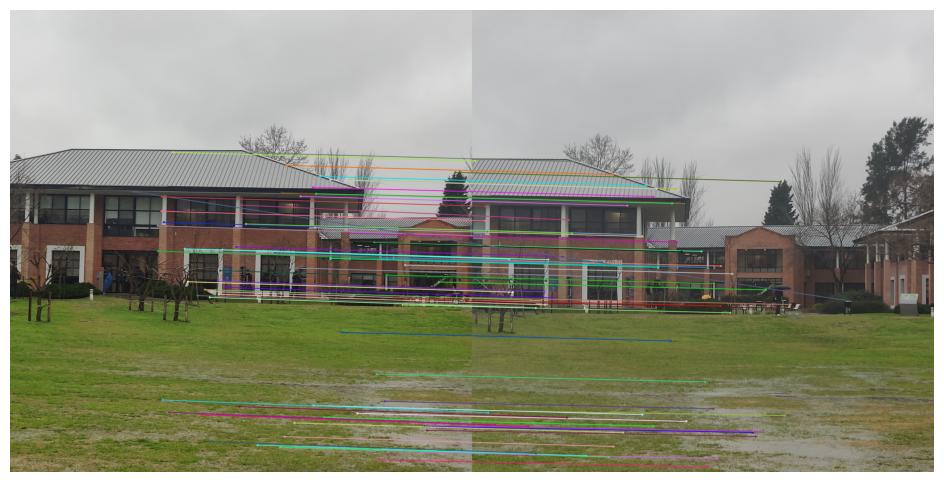

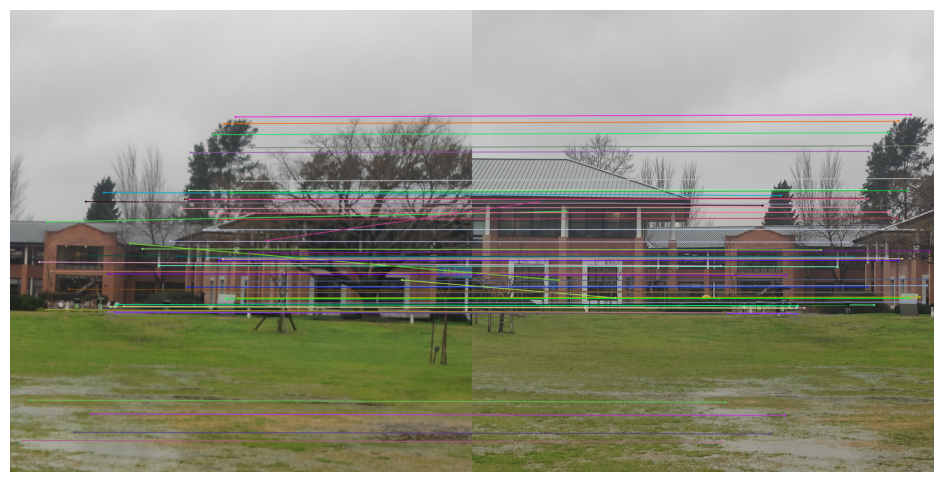

[CUADRO] left-center -> lowe+cross: 94 matches
[CUADRO] right-center -> lowe+cross: 46 matches


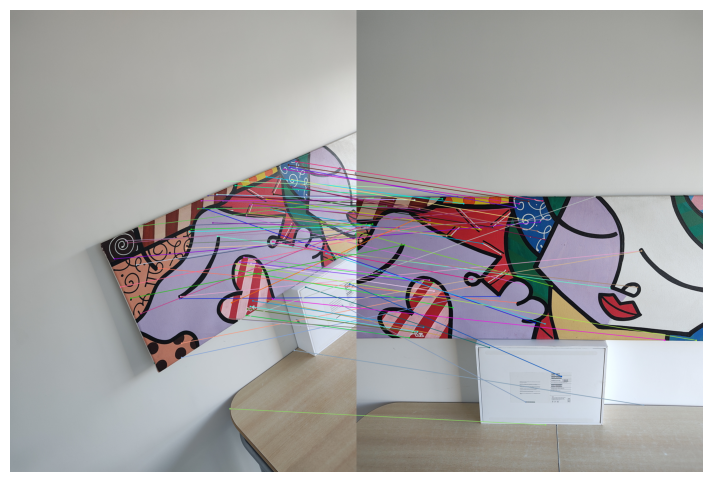

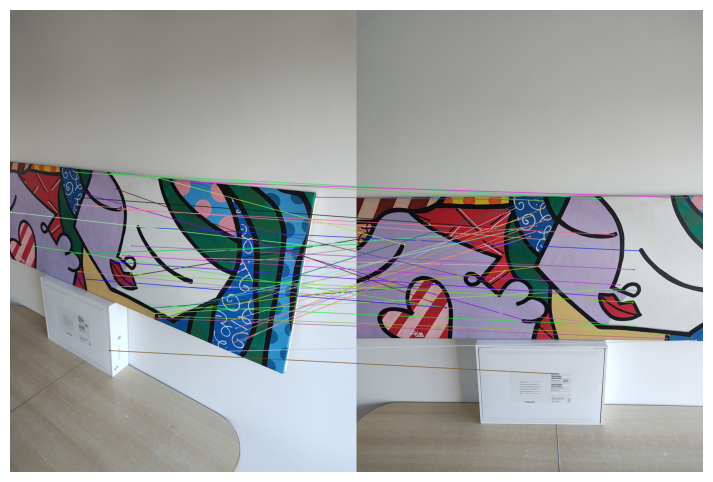

In [5]:
# matcheo los keypoints de udesa
ratio = 0.70

udesa_left, udesa_center, udesa_right = udesa
keypoints_udesa_left_anms, keypoints_udesa_center_anms, keypoints_udesa_right_anms = keypoints_udesa_anms
descriptors_udesa_left_anms, descriptors_udesa_center_anms, descriptors_udesa_right_anms = descriptors_udesa_anms

udesa_match_left_center, udesa_points_left, udesa_points_center_left = match_lowe_cross(keypoints_udesa_left_anms, descriptors_udesa_left_anms, keypoints_udesa_center_anms, descriptors_udesa_center_anms, ratio=ratio)
print(f'[UDESA] left-center -> lowe+cross: {len(udesa_match_left_center)} matches')

udesa_match_right_center, udesa_points_right, udesa_points_center_right = match_lowe_cross(keypoints_udesa_right_anms, descriptors_udesa_right_anms, keypoints_udesa_center_anms, descriptors_udesa_center_anms, ratio=ratio)
print(f'[UDESA] right-center -> lowe+cross: {len(udesa_match_right_center)} matches')

draw_matches_thick_rgb(udesa_left,  keypoints_udesa_left_anms,  udesa_center, keypoints_udesa_center_anms, udesa_match_left_center, max_show=80, thickness=4, radius=7)
draw_matches_thick_rgb(udesa_right, keypoints_udesa_right_anms, udesa_center, keypoints_udesa_center_anms, udesa_match_right_center, max_show=80, thickness=4, radius=7)

# matcheo los keypoints del cuadro
cuadro_left, cuadro_center, cuadro_right = cuadro
keypoints_cuadro_left_anms, keypoints_cuadro_center_anms, keypoints_cuadro_right_anms = keypoints_cuadro_anms
descriptors_cuadro_left_anms, descriptors_cuadro_center_anms, descriptors_cuadro_right_anms = descriptors_cuadro_anms

cuadro_match_left_center, cuadro_points_left, cuadro_points_center_left = match_lowe_cross(keypoints_cuadro_left_anms, descriptors_cuadro_left_anms, keypoints_cuadro_center_anms, descriptors_cuadro_center_anms, ratio=ratio)
print(f'[CUADRO] left-center -> lowe+cross: {len(cuadro_match_left_center)} matches')

cuadro_match_right_center, cuadro_points_right, cuadro_points_center_right = match_lowe_cross(keypoints_cuadro_right_anms, descriptors_cuadro_right_anms, keypoints_cuadro_center_anms, descriptors_cuadro_center_anms, ratio=ratio)
print(f'[CUADRO] right-center -> lowe+cross: {len(cuadro_match_right_center)} matches')

draw_matches_thick_rgb(cuadro_left,  keypoints_cuadro_left_anms, cuadro_center, keypoints_cuadro_center_anms, cuadro_match_left_center, max_show=80, thickness=4, radius=7)
draw_matches_thick_rgb(cuadro_right, keypoints_cuadro_right_anms, cuadro_center, keypoints_cuadro_center_anms, cuadro_match_right_center, max_show=80, thickness=4, radius=7)

#### Paso 4: Estimación de la homografía

##### Homografía entre la imagen central y la izquierda, Homografía entre la imagen central y la derecha

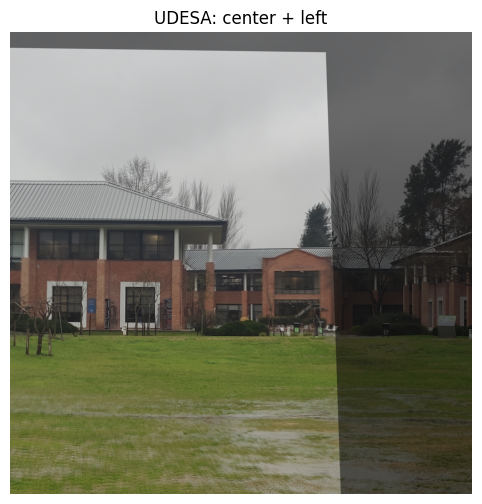

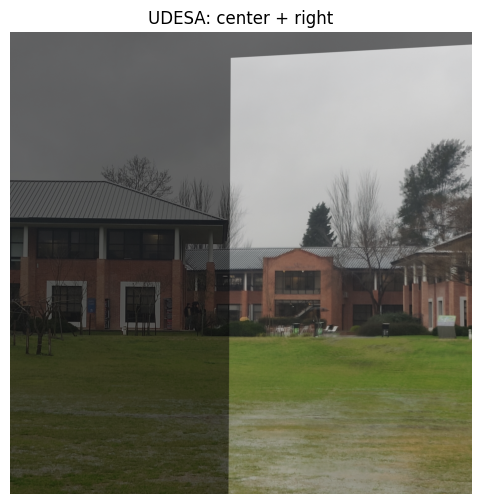

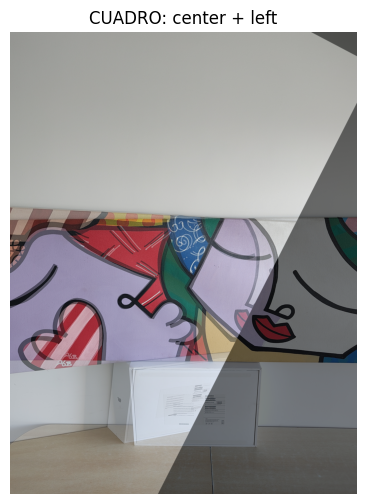

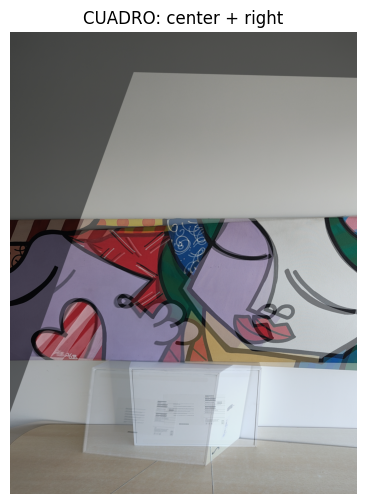

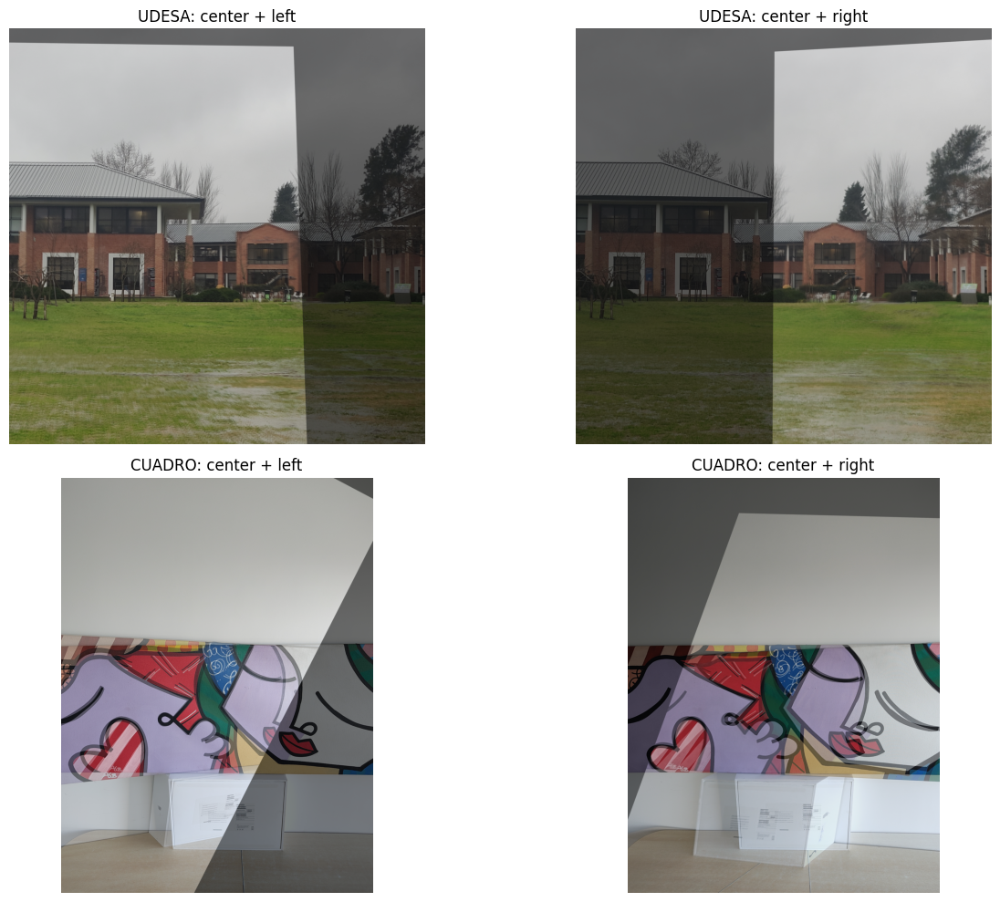

In [6]:
# homografías para udesa
# los puntos se seleccionaron usando el script.py
alpha = 0.5

udesa_center_left_coords = np.array([
    [264.66, 2121.49],
    [609.03, 1490.15],
    [1058.07, 1956.06],
    [1412.56, 1240.31]
], dtype=float)

udesa_center_right_coords = np.array([
    [1650.59, 1480.02],
    [2041.76, 1112.17],
    [2422.56, 1995.53],
    [2647.93, 1443.75]
], dtype=float)

udesa_left_coords = np.array([
    [1150.69, 2043.38],
    [1490.29, 1422.10],
    [1929.91, 1895.95],
    [2301.10, 1174.65]
], dtype=float)

udesa_right_coords = np.array([
    [233.93, 1456.17],
    [647.39, 1087.76],
    [999.90, 1986.25],
    [1251.69, 1450.86]
], dtype=float)

udesa_left_center_homography, udesa_left_warp, udesa_left_center_overlay = warp_to_center_and_overlay(udesa_left, udesa_center, udesa_left_coords, udesa_center_left_coords, 'UDESA: center + left', alpha=alpha)
udesa_right_center_homography, udesa_right_warp, udesa_right_center_overlay = warp_to_center_and_overlay(udesa_right, udesa_center, udesa_right_coords, udesa_center_right_coords, 'UDESA: center + right', alpha=alpha)

# homografías para el cuadro
cuadro_center_left_coords = np.array([
    (403.94, 2092.69),
    (773.65, 1737.34),
    (1085.93, 2412.15),
    (1760.73, 1895.27),
], dtype=float)

cuadro_center_right_coords = np.array([
    (469.09, 2687.63),
    (1246.94, 2221.64),
    (2791.89, 1666.03),
    (3071.48, 2486.89)
], dtype=float)

cuadro_left_coords = np.array([
    (1857.39, 2028.07), 
    (1993.61, 1662.45), 
    (2373.57, 2053.16), 
    (2649.58, 1468.88)
], dtype=float)

cuadro_right_coords = np.array([
    (100.06, 2099.76),
    (415.51, 1830.92),
    (1322.40, 1511.90),
    (1630.67, 2418.79),
], dtype=float)

cuadro_left_center_homography, cuadro_left_warp, cuadro_left_center_overlay = warp_to_center_and_overlay(cuadro_left, cuadro_center, cuadro_left_coords, cuadro_center_left_coords, 'CUADRO: center + left', alpha=alpha)
cuadro_right_center_homography, cuadro_right_warp, cuadro_right_center_overlay = warp_to_center_and_overlay(cuadro_right, cuadro_center, cuadro_right_coords, cuadro_center_right_coords, 'CUADRO: center + right', alpha=alpha)

fig, ax = plt.subplots(2, 2, figsize=(14,10))
ax[0,0].imshow(udesa_left_center_overlay)
ax[0,0].set_title('UDESA: center + left')
ax[0,0].axis('off')
ax[0,1].imshow(udesa_right_center_overlay)
ax[0,1].set_title('UDESA: center + right')
ax[0,1].axis('off')
ax[1,0].imshow(cuadro_left_center_overlay)
ax[1,0].set_title('CUADRO: center + left')
ax[1,0].axis('off')
ax[1,1].imshow(cuadro_right_center_overlay)
ax[1,1].set_title('CUADRO: center + right')
ax[1,1].axis('off')
plt.tight_layout()
plt.show()

#### Paso 5: Estimación de la homografía pero usando RANSAC

Homografía con RANSAC H (center -> left):
 [[ 9.44720170e-01 -1.03421992e-02  9.17621641e+02]
 [-1.67627833e-02  9.81906068e-01 -3.95940761e+01]
 [-1.57660168e-05 -2.69825366e-07  1.00000000e+00]]
Homografía con RANSAC H (center -> right):
 [[ 1.09581860e+00 -4.27436245e-02 -1.49857863e+03]
 [ 7.82566592e-02  1.07000232e+00 -1.90635612e+02]
 [ 3.08713947e-05 -1.85988843e-06  1.00000000e+00]]


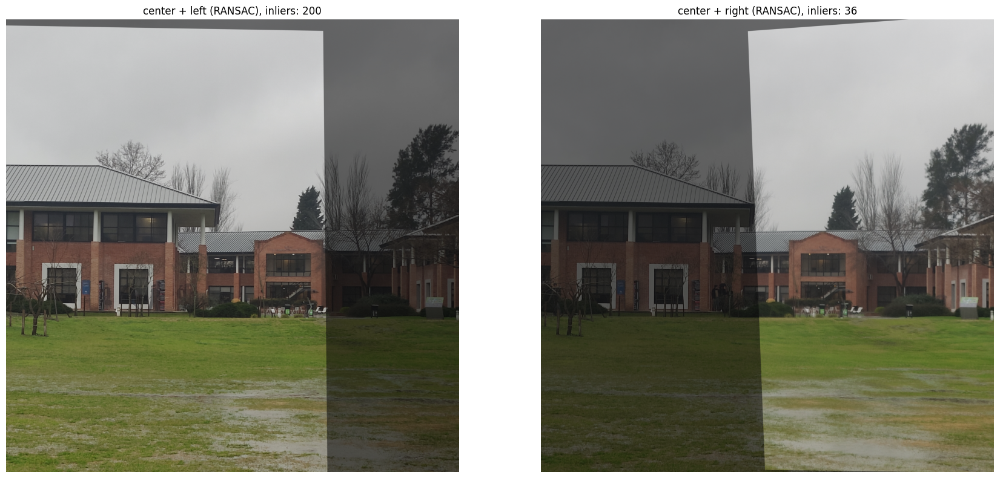

Homografía con RANSAC H (center -> left):
 [[ 9.20673061e-01  1.93384780e-01  1.06249001e+03]
 [-1.26653014e-01  8.09933148e-01  3.69341594e+02]
 [ 1.11451658e-04 -2.36487087e-05  1.00000000e+00]]
Homografía con RANSAC H (center -> right):
 [[ 3.46794739e-01  1.43755339e-02 -1.23775335e+02]
 [-1.38443844e-01  6.73563947e-01  2.39701516e+02]
 [-1.26547629e-04  4.72079205e-06  1.00000000e+00]]


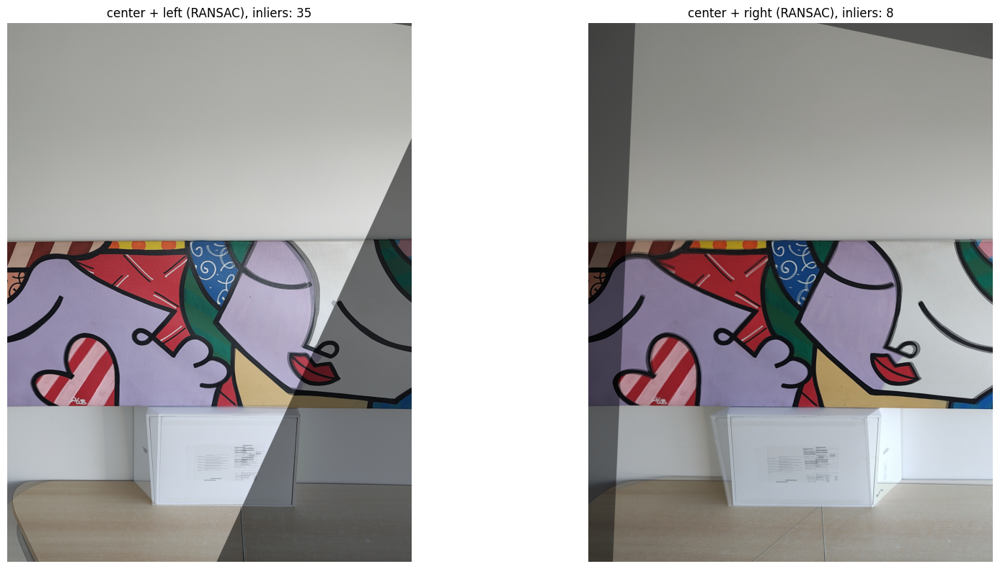

In [13]:
# RANSAC para udesa

# ransac left
udesa_H_ransac_left, udesa_inliers_left = ransac_homography(udesa_points_center_left, udesa_points_left, thresh=5.0, max_iters=1000, confidence=0.99)
print('Homografía con RANSAC H (center -> left):\n', udesa_H_ransac_left)

h, w = udesa_center.shape[:2]
udesa_left_warped_ransac = cv2.warpPerspective(udesa_left, np.linalg.inv(udesa_H_ransac_left), (w, h))

udesa_overlay_left_ransac = cv2.addWeighted(
    cv2.cvtColor(udesa_center, cv2.COLOR_BGR2RGB), 1 - alpha,
    cv2.cvtColor(udesa_left_warped_ransac, cv2.COLOR_BGR2RGB), alpha, 0
)

# ransac right
udesa_H_ransac_right, udesa_inliers_right = ransac_homography(udesa_points_center_right, udesa_points_right, thresh=5.0, max_iters=1000, confidence=0.99)
print('Homografía con RANSAC H (center -> right):\n', udesa_H_ransac_right)

udesa_right_warped_ransac = cv2.warpPerspective(udesa_right, np.linalg.inv(udesa_H_ransac_right), (w, h))
udesa_overlay_right_ransac = cv2.addWeighted(
    cv2.cvtColor(udesa_center, cv2.COLOR_BGR2RGB), 1 - alpha,
    cv2.cvtColor(udesa_right_warped_ransac, cv2.COLOR_BGR2RGB), alpha, 0
)

# grafico
fig, ax = plt.subplots(1, 2, figsize=(18, 8))

ax[0].imshow(cv2.cvtColor(udesa_overlay_left_ransac, cv2.COLOR_BGR2RGB))
ax[0].set_title(f'center + left (RANSAC), inliers: {len(udesa_inliers_left)}')
ax[0].axis('off')

ax[1].imshow(cv2.cvtColor(udesa_overlay_right_ransac, cv2.COLOR_BGR2RGB))
ax[1].set_title(f'center + right (RANSAC), inliers: {len(udesa_inliers_right)}')
ax[1].axis('off')

plt.tight_layout()
plt.show()

# hacemos lo mismo para el cuadro
# ransac left

cuadro_H_ransac_left, cuadro_inliers_left = ransac_homography(cuadro_points_center_left, cuadro_points_left, thresh=5.0, max_iters=1000, confidence=0.99)
print('Homografía con RANSAC H (center -> left):\n', cuadro_H_ransac_left)

h, w = cuadro_center.shape[:2]
cuadro_left_warped_ransac = cv2.warpPerspective(cuadro_left, np.linalg.inv(cuadro_H_ransac_left), (w, h))

cuadro_overlay_left_ransac = cv2.addWeighted(
    cv2.cvtColor(cuadro_center, cv2.COLOR_BGR2RGB), 1 - alpha,
    cv2.cvtColor(cuadro_left_warped_ransac, cv2.COLOR_BGR2RGB), alpha, 0
)

# ransac right
cuadro_H_ransac_right, cuadro_inliers_right = ransac_homography(cuadro_points_center_right, cuadro_points_right, thresh=5.0, max_iters=1000, confidence=0.99)
print('Homografía con RANSAC H (center -> right):\n', cuadro_H_ransac_right)

cuadro_right_warped_ransac = cv2.warpPerspective(cuadro_right, np.linalg.inv(cuadro_H_ransac_right), (w, h))
cuadro_overlay_right_ransac = cv2.addWeighted(
    cv2.cvtColor(cuadro_center, cv2.COLOR_BGR2RGB), 1 - alpha,
    cv2.cvtColor(cuadro_right_warped_ransac, cv2.COLOR_BGR2RGB), alpha, 0
)

# grafico
fig, ax = plt.subplots(1, 2, figsize=(18, 8))

ax[0].imshow(cv2.cvtColor(cuadro_overlay_left_ransac, cv2.COLOR_BGR2RGB))
ax[0].set_title(f'center + left (RANSAC), inliers: {len(cuadro_inliers_left)}')
ax[0].axis('off')

ax[1].imshow(cv2.cvtColor(cuadro_overlay_right_ransac, cv2.COLOR_BGR2RGB))
ax[1].set_title(f'center + right (RANSAC), inliers: {len(cuadro_inliers_right)}')
ax[1].axis('off')

plt.tight_layout()
plt.show()

#### Paso 6: Cálculo de tamaño óptimo para imagen final

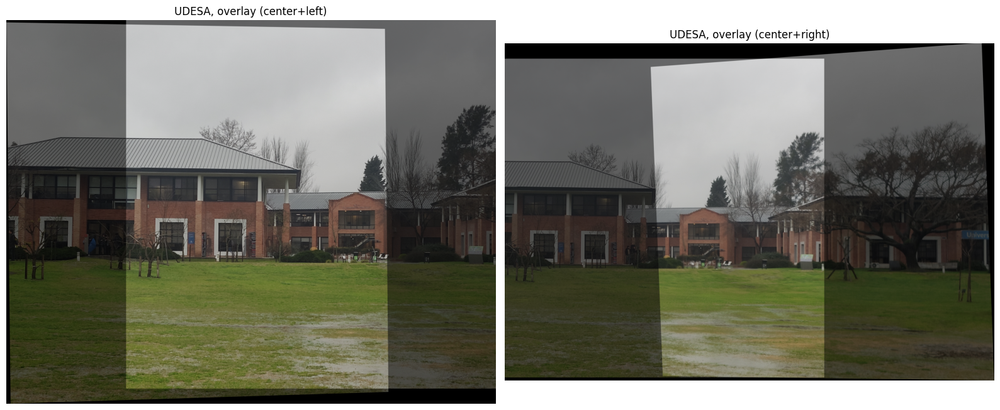

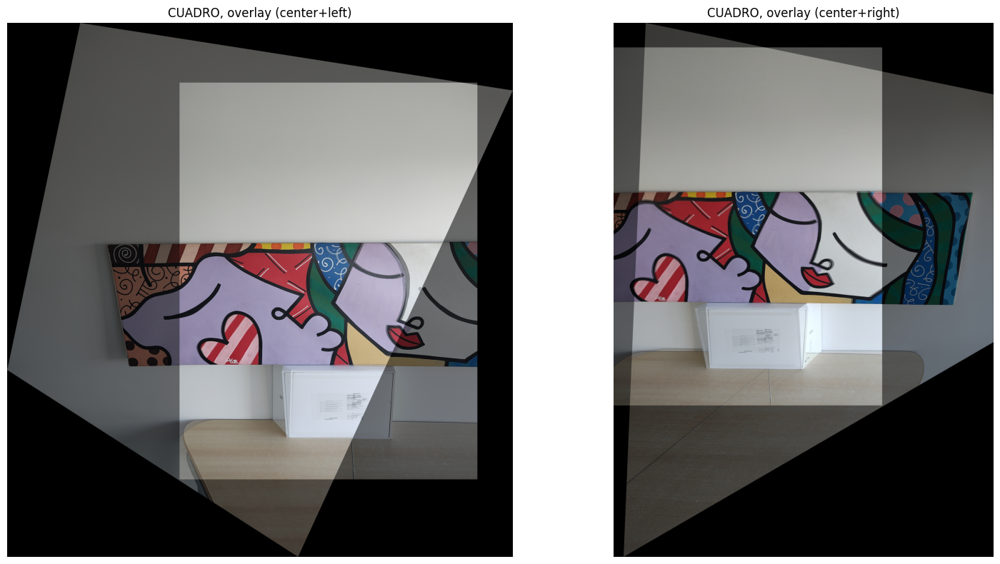

In [14]:
alpha = 0.5

# udesa
overlay_left_udesa, overlay_right_udesa = build_overlays_for_dataset_rgb(center_rgb=udesa_center, left_rgb=udesa_left, right_rgb=udesa_right, H_center_to_left=udesa_H_ransac_left, H_center_to_right=udesa_H_ransac_right, alpha=alpha)
plot_overlays_pair_rgb(overlay_left_udesa, overlay_right_udesa, 'UDESA, overlay (center+left)', 'UDESA, overlay (center+right)')

# cuadro
overlay_left_cuadro, overlay_right_cuadro = build_overlays_for_dataset_rgb(center_rgb=cuadro_center, left_rgb=cuadro_left, right_rgb=cuadro_right, H_center_to_left=cuadro_H_ransac_left, H_center_to_right=cuadro_H_ransac_right, alpha=alpha)
plot_overlays_pair_rgb(overlay_left_cuadro, overlay_right_cuadro, 'CUADRO, overlay (center+left)', 'CUADRO, overlay (center+right)')

#### Paso 7: Stitching and blending

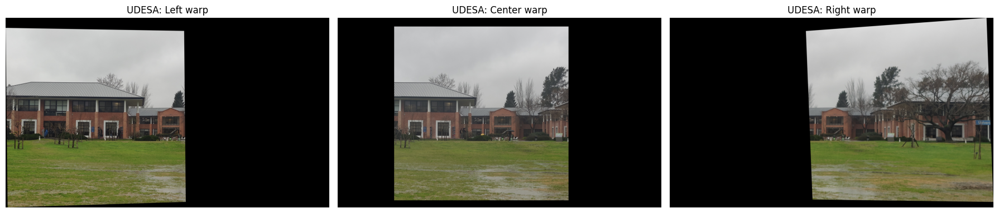

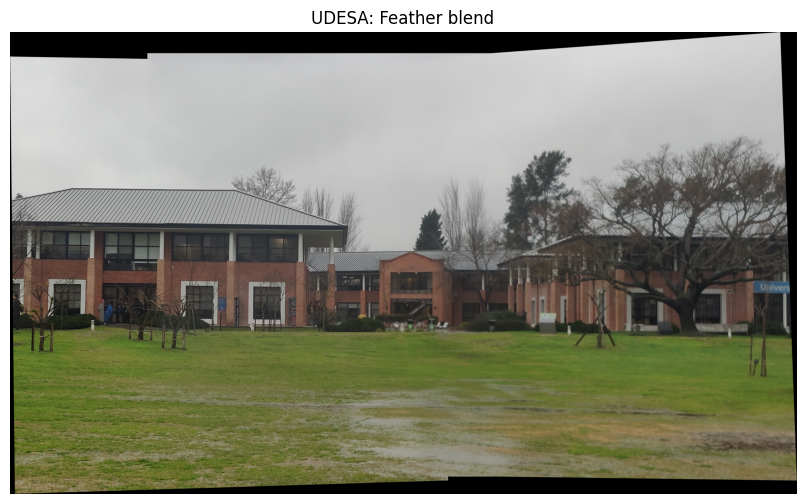

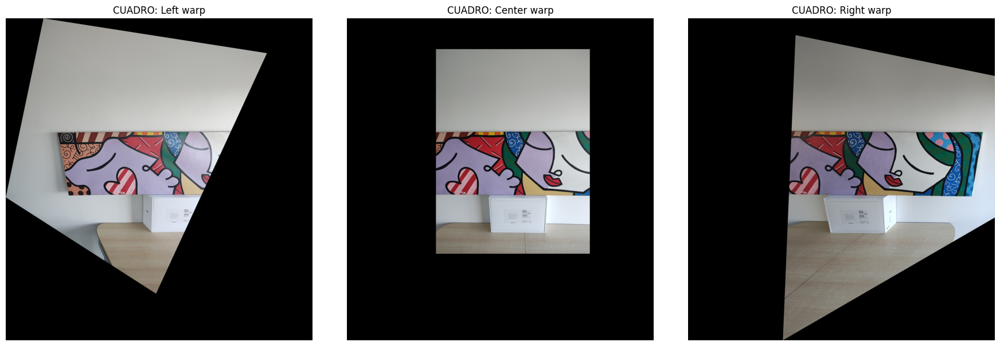

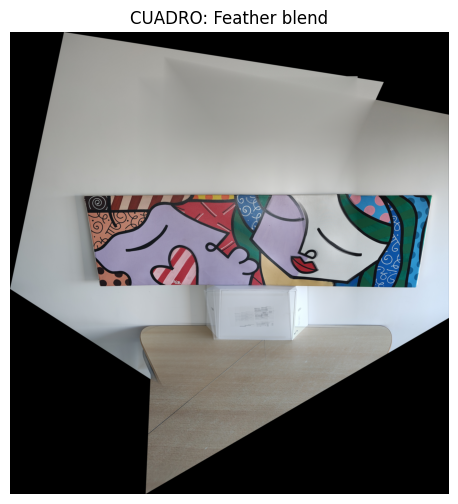

In [15]:

# udesa
udesa_left_warp, udesa_center_warp, udesa_right_warp, udesa_pano = build_and_blend_panorama_rgb('UDESA', udesa_left, udesa_center, udesa_right, H_center_to_left=udesa_H_ransac_left, H_center_to_right=udesa_H_ransac_right, show_intermediate=True)

# cuadro
cuadro_left_warp, cuadro_center_warp, cuadro_right_warp, cuadro_pano = build_and_blend_panorama_rgb('CUADRO', cuadro_left, cuadro_center, cuadro_right, H_center_to_left=cuadro_H_ransac_left, H_center_to_right=cuadro_H_ransac_right, show_intermediate=True)


### Seguimos el mismo pipeline pero utilizando nuestras imágenes

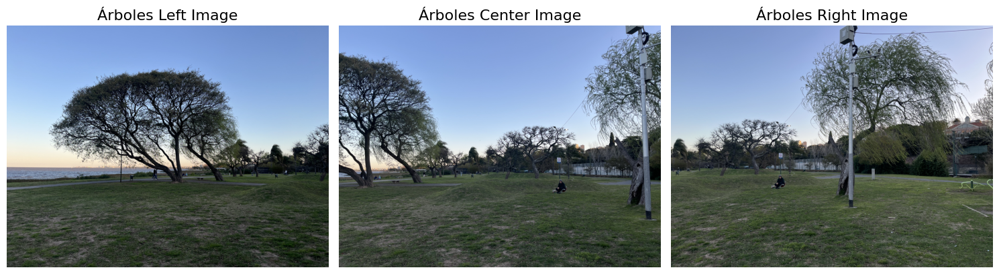

In [16]:
# cargo las imágenes y las paso a RGB
arboles = [cv2.cvtColor(cv2.imread(f'img/arbol_{i}.jpeg'),  cv2.COLOR_BGR2RGB) for i in range(3)]

graph_images(arboles)

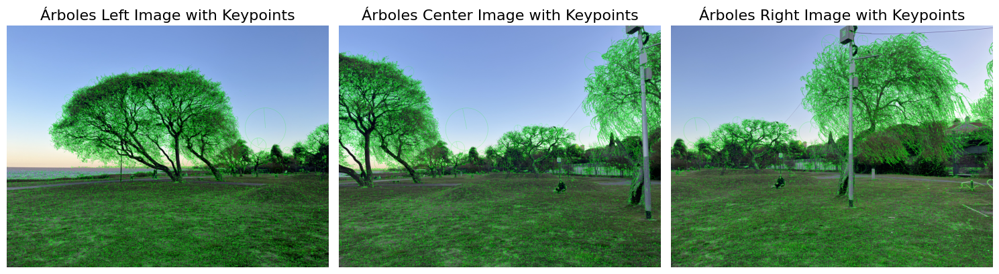

In [17]:
# aplico sift
(keypoints_arboles, descriptors_arboles, visual_arboles) = sift_kps_images(arboles)

graph_images(visual_arboles, titles=['Árboles Left Image with Keypoints', 'Árboles Center Image with Keypoints', 'Árboles Right Image with Keypoints'])

/Users/fedegutman/Desktop/visión artificial/tp1_panoramica/src/visualization.py:36: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


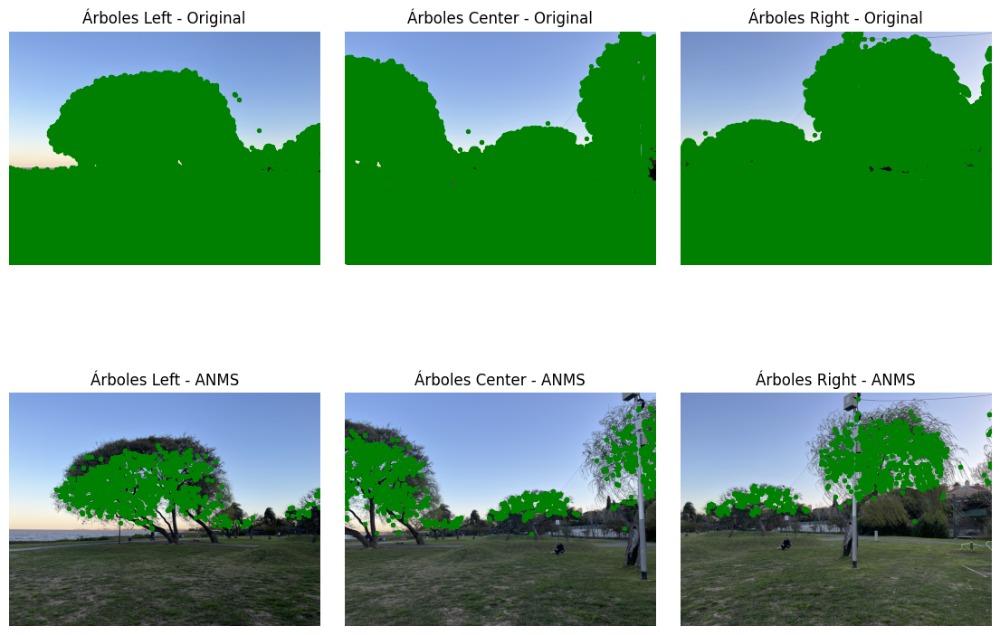

In [ ]:
keypoints_arboles_anms, descriptors_arboles_anms, radii_arboles = apply_anms_triplet(keypoints_arboles, descriptors_arboles, N=3000)

plot_triplet_keypoints(arboles, keypoints_arboles, keypoints_arboles_anms, title_prefix='Árboles')

[ÁRBOLES] left-center -> lowe+cross: 16 matches
[ÁRBOLES] right-center -> lowe+cross: 64 matches


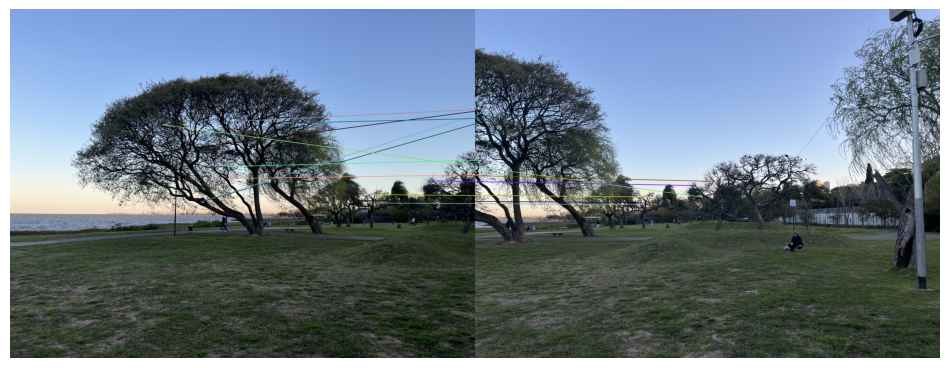

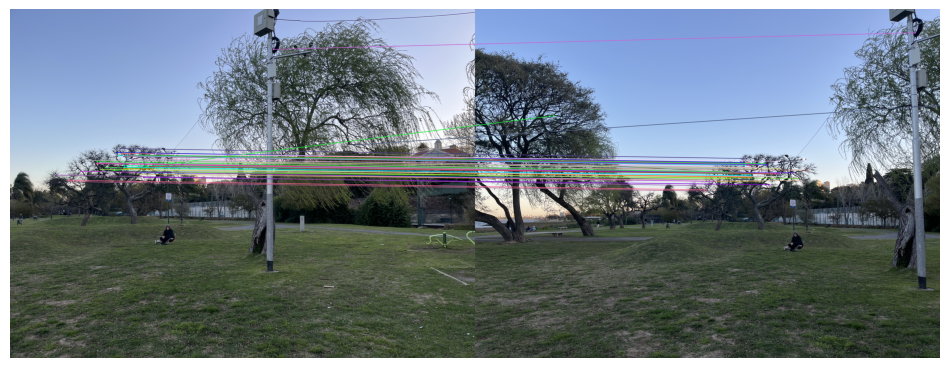

In [20]:
# matcheo los keypoints de los arboles
arboles_left, arboles_center, arboles_right = arboles
keypoints_arboles_left_anms, keypoints_arboles_center_anms, keypoints_arboles_right_anms = keypoints_arboles_anms
descriptors_arboles_left_anms, descriptors_arboles_center_anms, descriptors_arboles_right_anms = descriptors_arboles_anms

arboles_match_left_center, arboles_points_left, arboles_points_center_left = match_lowe_cross(keypoints_arboles_left_anms, descriptors_arboles_left_anms, keypoints_arboles_center_anms, descriptors_arboles_center_anms, ratio=ratio)
print(f'[ÁRBOLES] left-center -> lowe+cross: {len(arboles_match_left_center)} matches')

arboles_match_right_center, arboles_points_right, arboles_points_center_right = match_lowe_cross(keypoints_arboles_right_anms, descriptors_arboles_right_anms, keypoints_arboles_center_anms, descriptors_arboles_center_anms, ratio=ratio)
print(f'[ÁRBOLES] right-center -> lowe+cross: {len(arboles_match_right_center)} matches')

draw_matches_thick_rgb(arboles_left, keypoints_arboles_left_anms, arboles_center, keypoints_arboles_center_anms, arboles_match_left_center, max_show=80, thickness=4, radius=7)
draw_matches_thick_rgb(arboles_right, keypoints_arboles_right_anms, arboles_center, keypoints_arboles_center_anms, arboles_match_right_center, max_show=80, thickness=4, radius=7)

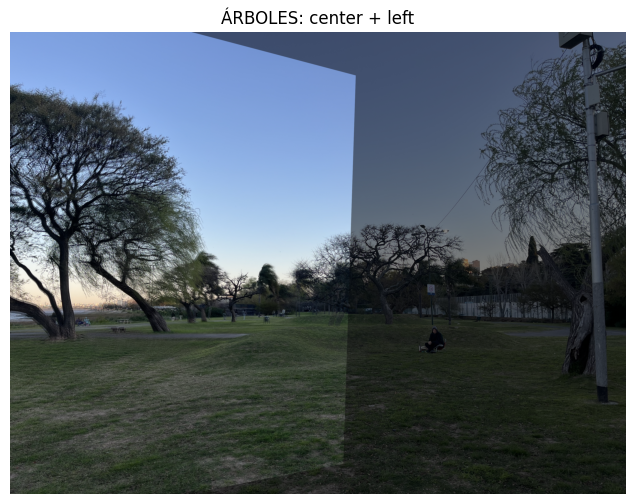

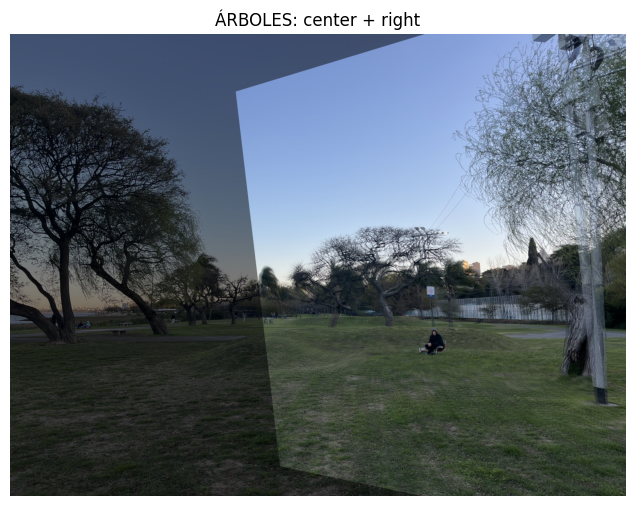

In [21]:
# homografías para árboles

arboles_center_left_coords = np.array([
    (736.66, 463.58),
    (20.16, 1443.90),
    (1270.29, 1914.57),
    (1561.09, 1578.80)
], dtype=float)

arboles_center_right_coords = np.array([
    (2787.62, 1970.25),
    (3423.57, 1348.67),
    (2446.29, 1718.74),
    (3991.26, 2448.11)
], dtype=float)

arboles_left_coords = np.array([
    (2414.11, 537.80),
    (1890.82, 1476.01),
    (2940.03, 1906.79),
    (3230.75, 1557.93)
], dtype=float)

arboles_right_coords = np.array([
    (1378.95, 1913.96),
    (2005.89, 1338.97),
    (1049.89, 1657.64),
    (2341.87, 2288.04)
], dtype=float)

arboles_left_center_homography, arboles_left_warp, arboles_left_center_overlay = warp_to_center_and_overlay(arboles_left, arboles_center, arboles_left_coords, arboles_center_left_coords, 'ÁRBOLES: center + left', alpha=alpha)
arboles_right_center_homography,arboles_right_warp, arboles_right_center_overlay = warp_to_center_and_overlay(arboles_right, arboles_center, arboles_right_coords, arboles_center_right_coords, 'ÁRBOLES: center + right', alpha=alpha)

Homografía con RANSAC H (center -> left):
 [[ 3.86212335e-01  2.86500107e-02  1.85598098e+03]
 [-2.58752279e-01  8.38641103e-01  2.82944463e+02]
 [-1.54166912e-04  8.90370166e-06  1.00000000e+00]]
Homografía con RANSAC H (center -> right):
 [[ 1.97620856e+00 -7.70594244e-02 -3.08125764e+03]
 [ 4.31046644e-01  1.58814503e+00 -1.20961323e+03]
 [ 2.51571503e-04 -3.97371658e-05  1.00000000e+00]]


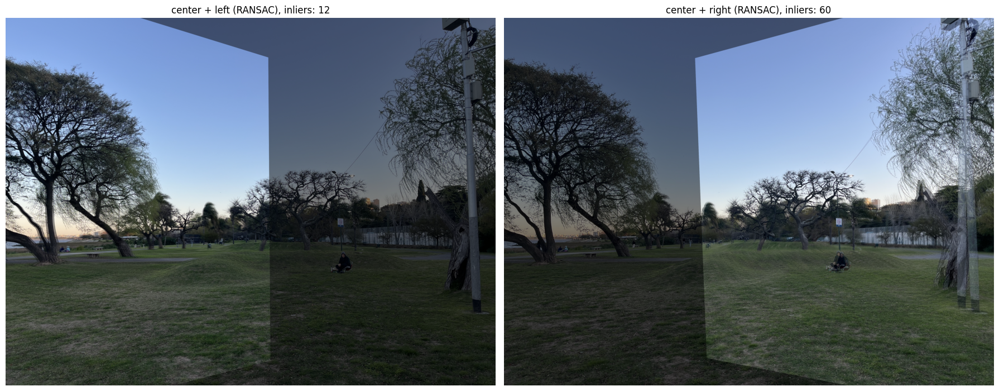

In [22]:
# RANSAC para arboles

# ransac left
arboles_H_ransac_left, arboles_inliers_left = ransac_homography(arboles_points_center_left, arboles_points_left, thresh=5.0, max_iters=1000, confidence=0.99)
print('Homografía con RANSAC H (center -> left):\n', arboles_H_ransac_left)

h, w = arboles_center.shape[:2]
arboles_left_warped_ransac = cv2.warpPerspective(arboles_left, np.linalg.inv(arboles_H_ransac_left), (w, h))

arboles_overlay_left_ransac = cv2.addWeighted(
    cv2.cvtColor(arboles_center, cv2.COLOR_BGR2RGB), 1 - alpha,
    cv2.cvtColor(arboles_left_warped_ransac, cv2.COLOR_BGR2RGB), alpha, 0
)

# ransac right
arboles_H_ransac_right, arboles_inliers_right = ransac_homography(arboles_points_center_right, arboles_points_right, thresh=5.0, max_iters=1000, confidence=0.99)
print('Homografía con RANSAC H (center -> right):\n', arboles_H_ransac_right)

arboles_right_warped_ransac = cv2.warpPerspective(arboles_right, np.linalg.inv(arboles_H_ransac_right), (w, h))
arboles_overlay_right_ransac = cv2.addWeighted(
    cv2.cvtColor(arboles_center, cv2.COLOR_BGR2RGB), 1 - alpha,
    cv2.cvtColor(arboles_right_warped_ransac, cv2.COLOR_BGR2RGB), alpha, 0
)

# grafico
fig, ax = plt.subplots(1, 2, figsize=(18, 8))

ax[0].imshow(cv2.cvtColor(arboles_overlay_left_ransac, cv2.COLOR_BGR2RGB))
ax[0].set_title(f'center + left (RANSAC), inliers: {len(arboles_inliers_left)}')
ax[0].axis('off')

ax[1].imshow(cv2.cvtColor(arboles_overlay_right_ransac, cv2.COLOR_BGR2RGB))
ax[1].set_title(f'center + right (RANSAC), inliers: {len(arboles_inliers_right)}')
ax[1].axis('off')

plt.tight_layout()
plt.show()

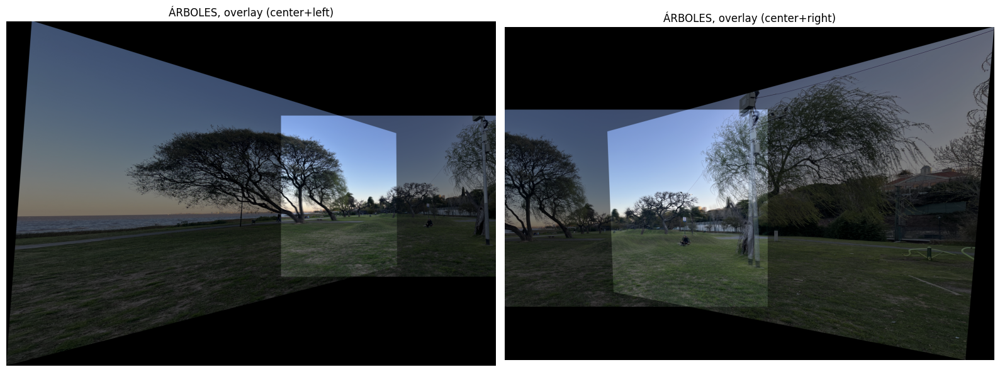

In [23]:
overlay_left_arboles, overlay_right_arboles = build_overlays_for_dataset_rgb(center_rgb=arboles_center, left_rgb=arboles_left, right_rgb=arboles_right, H_center_to_left=arboles_H_ransac_left, H_center_to_right=arboles_H_ransac_right, alpha=alpha)
plot_overlays_pair_rgb(overlay_left_arboles, overlay_right_arboles, 'ÁRBOLES, overlay (center+left)', 'ÁRBOLES, overlay (center+right)')

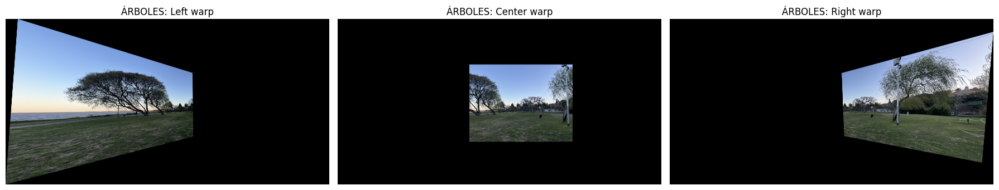

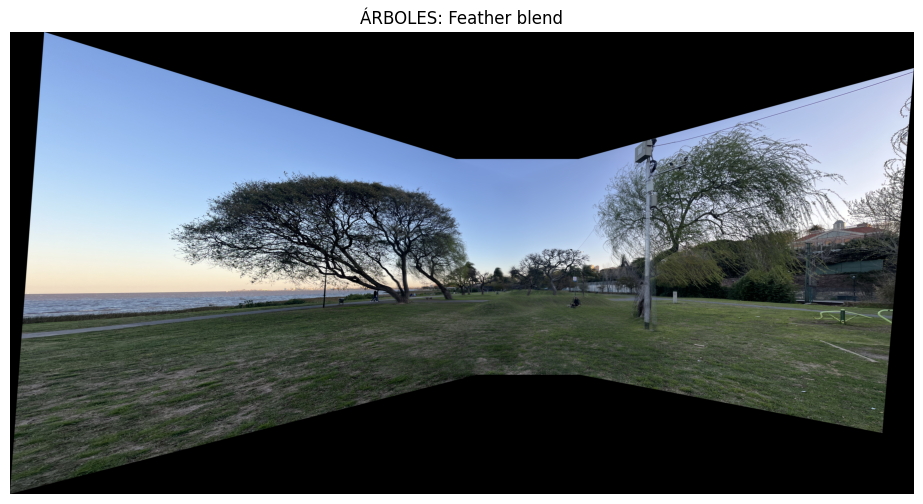

In [24]:
arboles_left_warp, arboles_center_warp, arboles_right_warp, arboles_pano = build_and_blend_panorama_rgb('ÁRBOLES', arboles_left, arboles_center, arboles_right, H_center_to_left=arboles_H_ransac_left, H_center_to_right=arboles_H_ransac_right, show_intermediate=True)